In [59]:
# Importacion.
# import librosa
from scipy.io import wavfile
import IPython
import os
import sys
import numpy as np
import matplotlib.pyplot as plt

In [2]:
# Directorios que usaremos.
cwd = os.getcwd()
audio_input_path = os.path.join(cwd, os.path.join('audio', 'examples'))  # cambiar '_input' por 'examples'
audio_output_path = os.path.join(cwd, os.path.join('audio', '_output'))
print(f'Directorio con los audios de entrada: {audio_input_path}')
print(f'Directorio donde guardaremos los audios generados: {audio_output_path}\n')

Directorio con los audios de entrada: /home/javier/asignaturas/sm/tarea-4/tarea-audio/audio/examples
Directorio donde guardaremos los audios generados: /home/javier/asignaturas/sm/tarea-4/tarea-audio/audio/_output



In [3]:
# Cargamos el archivo de audio.
filename = os.path.join(audio_input_path, 'interstellar.wav')
# audio_data, sample_rate = librosa.load(filename, sr=None, mono=False)
sample_rate, audio_data = wavfile.read(filename)
print(f'Frecuencia de muestreo (sample rate): {sample_rate/1000} kHz')

Frecuencia de muestreo (sample rate): 44.1 kHz


In [4]:
IPython.display.Audio(audio_data.T, rate=sample_rate)

In [5]:
# Mostrar informacion (sonido estéreo).
print('Datos de audio (estereo):')
print(f'- Tamaño:     {audio_data.shape}')
print(f'- 1º canal:   {audio_data[:5, 0]}...')
print(f'- 2º canal:   {audio_data[:5, 1]}...')
print(f'- Resolucion: {type(audio_data[0,0])}\n')

Datos de audio (estereo):
- Tamaño:     (2171299, 2)
- 1º canal:   [6906 7406 7882 8401 8839]...
- 2º canal:   [-4619 -4763 -4899 -5100 -5283]...
- Resolucion: <class 'numpy.int16'>



In [39]:
# Convertimos a mono mediante la media por canal (simplificacion).
audio_mono = audio_data.mean(axis=1)  # Column-wise.
print('Nuevos datos de audio (mono):')
print(f'- Nuevo tamaño: {audio_mono.shape}')
print(f'- Canal unico:  {audio_mono[:5]}...')

# Mantenemos la misma resolucion que antes.
audio_mono = audio_mono.astype(np.int16)
print(f'- Resolucion:   {type(audio_mono[0])}\n')

Nuevos datos de audio (mono):
- Nuevo tamaño: (2171299,)
- Canal unico:  [1143.5 1321.5 1491.5 1650.5 1778. ]...
- Resolucion:   <class 'numpy.int16'>



In [58]:
# Guardamos el archivo mono a un fichero de tipo wav.
wavfile.write(
    filename=os.path.join(audio_output_path, 'audio_mono.wav'),
    rate=sample_rate,
    data=audio_mono
)

In [48]:
IPython.display.Audio(audio_mono, rate=sample_rate)

In [44]:
values_estereo = len(audio_data)
values_mono = len(audio_mono)
t1 = np.arange(0, values_estereo/sample_rate, 1/sample_rate)
t2 = np.arange(0, values_mono/sample_rate, 1/sample_rate)

## Mostrar la gráfica en el dominio del tiempo para el audio mono y el estéreo.

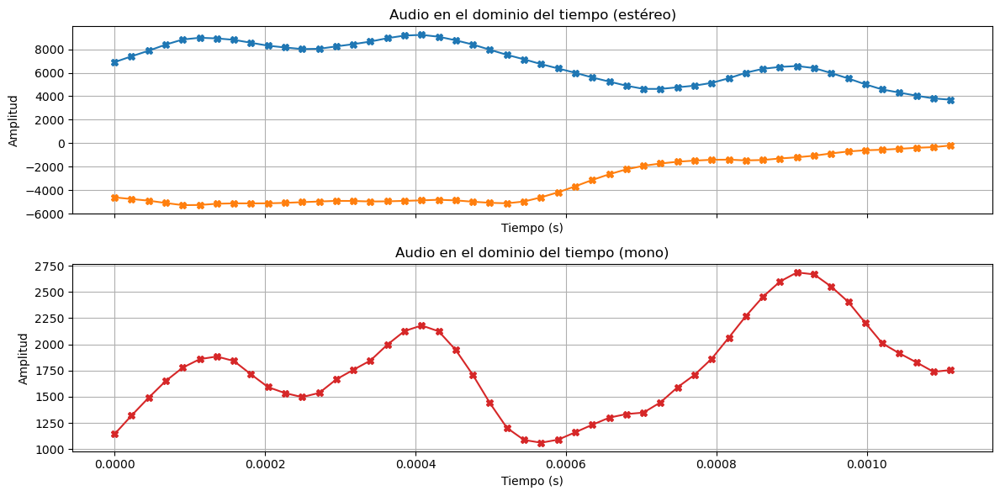

In [45]:
# Creamos la figura.
fig, ax = plt.subplots(2, 1, figsize=(12, 6), sharex=True)

# Solo mostramos las primeras 50 muestras de amplitud (por claridad).
end = 50

ax[0].plot(t1[:end], audio_data[:end], marker='X')
ax[0].set_title(f'Audio en el dominio del tiempo (estéreo)')
ax[0].set_xlabel('Tiempo (s)')
ax[0].set_ylabel('Amplitud')
ax[0].grid(True)

  
ax[1].plot(t2[:end], audio_mono[:end], c='tab:red', marker='X')
ax[1].set_title(f'Audio en el dominio del tiempo (mono)')
ax[1].set_xlabel('Tiempo (s)')
ax[1].set_ylabel('Amplitud')
ax[1].grid(True)

# Mostramos la figura.
plt.tight_layout()
plt.show()

## Explicar conceptos
<ul>
    <li>Audio estéreo:</li>
    <li>Audio mono:</li>
    <li>Frecuencia de muestreo:</li>
    <li>Aliasing:</li>
    <li>Profundidad de bits:</li>
    <li>Ancho de banda:</li>
    <li>Tasa de bits:</li>
</ul>

## Aplicar la Transformada rápida de Fourier.

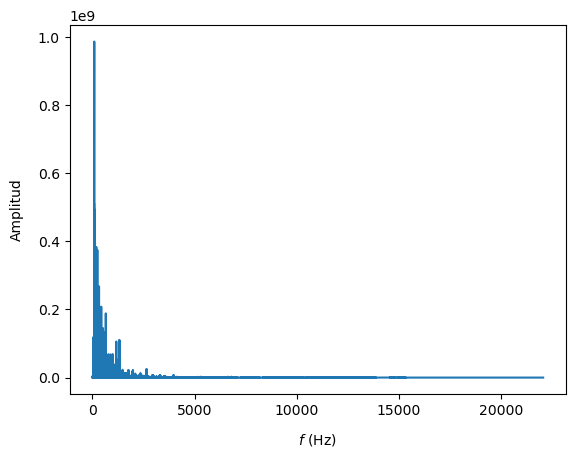

In [46]:
ch_Fourier = np.fft.fft(audio_mono)
abs_ch_Fourier = np.absolute(ch_Fourier[:values_mono//2])

# Graficamos.
plt.plot(np.linspace(0, sample_rate/2, values_mono//2), abs_ch_Fourier)
plt.ylabel('Amplitud', labelpad=10)
plt.xlabel('$f$ (Hz)', labelpad=10)
plt.show()

## Calcular la energía del espectrograma y la frecuencia de corte eligiendo un epsilon

Epsilon: 0.063
Valor de corte para la energia del espectro: 752322502748.539
Mascara: [False False False ...  True  True  True]
Frecuencia de corte f0 (Hz): 3982


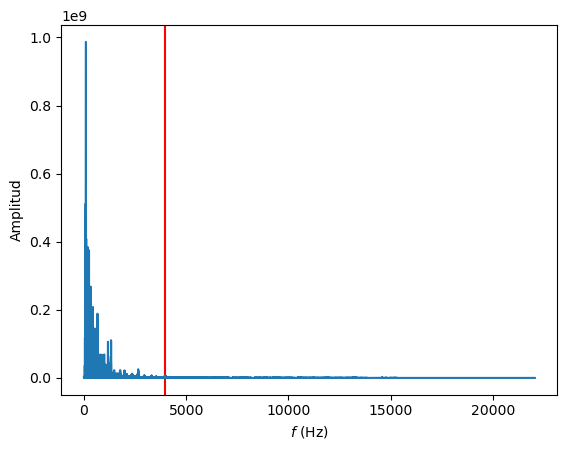

In [65]:
# Definimos epsilon: la parte de la energia
# del espectro que no conservamos.
eps = [1e-5, .02, .041, .063, .086, .101, .123]

# Jugamos con los valores de epsilon (CAMBIAD ESTO).
eps = eps[3]
print(f'Epsilon: {eps}')

# Calculamos el valor de corte para esta energia.
thr_spec_energy = (1 - eps) * np.sum(abs_ch_Fourier)
print(f'Valor de corte para la energia del espectro: {thr_spec_energy}')

# Integral de la frecuencia --> energia del espectro.
spec_energy = np.cumsum(abs_ch_Fourier)

# Mascara (array booleano) que compara el valor
# de corte con la energia del espectro.
frequencies_to_remove = thr_spec_energy < spec_energy  
print(f'Mascara: {frequencies_to_remove}')

# La frecuencia f0 por la que cortamos el espectro.
f0 = (len(frequencies_to_remove) - np.sum(frequencies_to_remove)) * (sample_rate/2) / (values_mono//2)
print(f'Frecuencia de corte f0 (Hz): {int(f0)}')

# Graficamos.
plt.axvline(f0, color='r')
plt.plot(np.linspace(0, sample_rate/2, values_mono//2), abs_ch_Fourier)
plt.ylabel('Amplitud')
plt.xlabel('$f$ (Hz)')
plt.show()

# Comprimir la onda aplicando downsampling.

In [66]:
# Definimos los nombres de los audios comprimidos.
wav_compressed_file = "audio_compressed.wav"

# Calculamos el factor D de downsampling.
D = int(sample_rate / f0)
print(f'Factor de downsampling: {D}')

# Obtenemos los nuevos datos (slicing with stride).
new_audio_mono = audio_mono[::D]
# Escribimos los datos a un archivo de tipo wav.
wavfile.write(
    filename=os.path.join(audio_output_path, wav_compressed_file),
    rate=int(sample_rate/D),
    data=new_audio_mono
)

# Cargamos el nuevo archivo.
compressed_sample_rate, compressed_audio_data = wavfile.read(filename=os.path.join(audio_output_path, wav_compressed_file))

Factor de downsampling: 11


## Mostrar el espectograma de ambas ondas

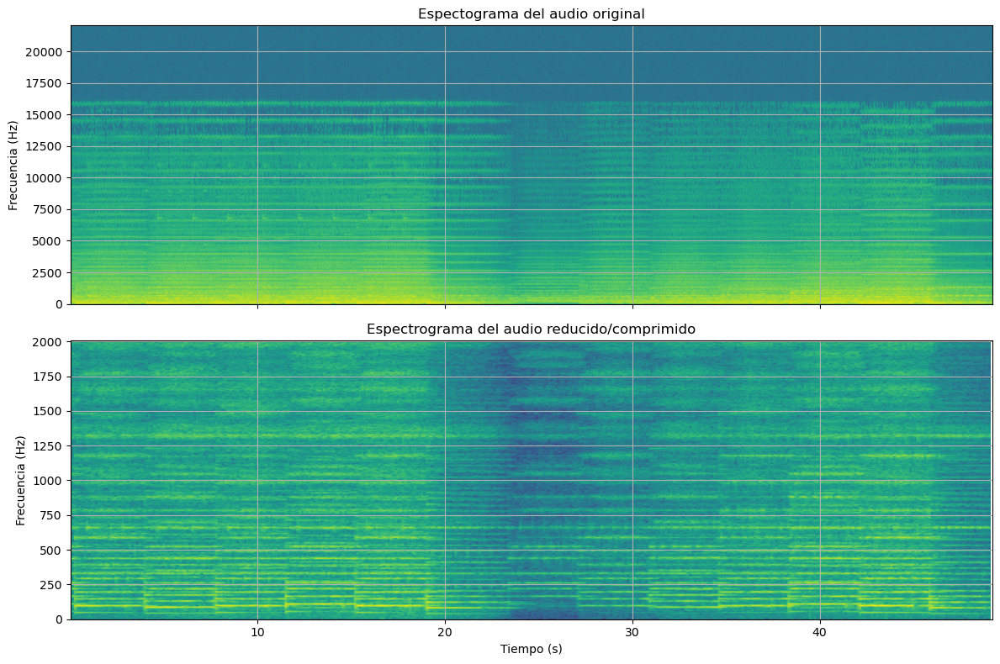

In [67]:
fig, ax = plt.subplots(2, 1, figsize=(12, 8), sharex=True)

Pxx, freqs, bins, im = ax[0].specgram(audio_mono, NFFT=1024, Fs=sample_rate, noverlap=512)
ax[0].set_title('Espectograma del audio original')
ax[0].set_ylabel('Frecuencia (Hz)')
ax[0].grid(True)

Pxx, freqs, bins, im = ax[1].specgram(compressed_audio_data, NFFT=1024, Fs=compressed_sample_rate, noverlap=512)
ax[1].set_title('Espectrograma del audio reducido/comprimido')
ax[1].set_xlabel('Tiempo (s)')
ax[1].set_ylabel('Frecuencia (Hz)')
ax[1].grid(True)

plt.tight_layout()
plt.show()

In [68]:
# Tamaño de audio_mono en MB
size_audio_mono = round(sys.getsizeof(audio_mono) / (1024 * 1024), 3)
print("Tamaño de audio_mono en MB:", size_audio_mono)

# Tamaño de new_audio_data en KB
size_new_audio_data = round(sys.getsizeof(compressed_audio_data) / (1024), 3)
print("Tamaño de new_audio_data en KB:", size_new_audio_data)

Tamaño de audio_mono en MB: 4.142
Tamaño de new_audio_data en KB: 385.639


In [69]:
IPython.display.Audio(audio_mono, rate=sample_rate)

In [70]:
IPython.display.Audio(compressed_audio_data, rate=compressed_sample_rate)